In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from astropy.io import votable
from astropy.table import Table
from astropy.io import fits
from Analysis import investigation_pipeline

## Unknown Results from Clustering Algorthim

| Name       | l Min | l Max | b Min   | b Max   | l Centre | b Centre |
|------------|-------|-------|---------|---------|----------|----------|
| Unknown 1  | 133   | 134   | -31.87  | -30.87  | 133.5    | -31.37   |
| Unknown 2  | 177   | 178   | -19.87  | -18.87  | 177.5    | -19.37   |
| Unknown 3  | 177   | 178   | 20.13   | 21.13   | 177.5    | 20.63    |
| Unknown 4  | 190   | 191   | -19.87  | -18.87  | 190.5    | -19.37   |
| Unknown 5  | 194   | 195   | 14.13   | 15.13   | 194.5    | 14.63    |
| Unknown 6  | 197   | 198   | 12.13   | 13.13   | 197.5    | 12.63    |
| Unknown 7  | 204   | 205   | -17.87  | -16.87  | 204.5    | -17.37   |
| Unknown 8  | 212   | 213   | -16.87  | -15.87  | 212.5    | -16.37   |
| Unknown 9  | 214   | 216   | 11.13   | 13.13   | 215      | 12.13    |
| Unknown 10 | 296   | 297   | 10.13   | 11.13   | 296.5    | 10.63    |
| Unknown 11 | 297   | 298   | -30.87  | -29.87  | 297.5    | -30.37   |
| Unknown 12 | 304   | 305   | -40.87  | -39.87  | 304.5    | -40.37   |

## Example Gaia Search Applied
- Tuned for each clusters centre

```sql
WHERE gs.phot_g_mean_mag BETWEEN 10 AND 21.5
  AND gs.parallax < 0.3
  AND gs.ruwe < 1.4
  AND gd.r_med_photogeo IS NOT NULL
  AND 1 = CONTAINS(
    POINT(304.5, -40.37),
    CIRCLE(gs.l, gs.b, 1.75)
  );
```

In [ ]:
# Load PMGC dataset from Vasilev et al. 2019 (PMGC_vasiliev2019res.fit)
# This is used for cross-matching with the Gaia dataset
PMGC_path = 'data/PMGC_vasiliev2019.fit'
with fits.open(PMGC_path) as PMGC_hdul:
    PMGC_data = Table(PMGC_hdul[1].data).to_pandas()

# Convert RA/Dec to Galactic coordinates (l, b)
sky_coords = SkyCoord(ra=PMGC_data['RAJ2000'].values * u.degree, 
                      dec=PMGC_data['DEJ2000'].values * u.degree, 
                      frame='icrs')
galactic_coords = sky_coords.galactic
PMGC_data['l'] = galactic_coords.l.deg
PMGC_data['b'] = galactic_coords.b.deg

# Display summary of the DataFrame
print("=== PMGC Dataset Summary ===")
print(PMGC_data.info())
print("\n=== First 5 Rows ===")
print(PMGC_data.head())




# Give you the option to select a specific cluster 
cluster_name = 'NGC 1841' 

# Print all unique cluster names
print("Available cluster names:")
print(PMGC_data['Name'].unique())

# Filter for a specific cluster (case-insensitive match)
cluster_name = 'NGC 1841'
cluster_match = PMGC_data[PMGC_data['Name'].str.upper() == cluster_name.upper()]

# Show the result
if not cluster_match.empty:
    print(f"\nFound cluster: {cluster_name}")
    print(cluster_match)
else:
    print(f"\nCluster '{cluster_name}' not found.")

=== PMGC Dataset Summary ===
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 18 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Name        150 non-null    object 
 1   OName       150 non-null    object 
 2   RAJ2000     150 non-null    float32
 3   DEJ2000     150 non-null    float32
 4   Dist        149 non-null    float32
 5   HRV         150 non-null    float32
 6   e_HRV       150 non-null    float32
 7   pmRA        150 non-null    float32
 8   pmDE        150 non-null    float32
 9   e_pmRA      150 non-null    float32
 10  e_pmDE      150 non-null    float32
 11  corr        150 non-null    float32
 12  Rscale      150 non-null    float32
 13  Nstar       150 non-null    int32  
 14  SimbadName  150 non-null    object 
 15  recno       150 non-null    int32  
 16  l           150 non-null    float64
 17  b           150 non-null    float64
dtypes: float32(11), float64(2), int32(2), obj

# Unknown 11 - NGC 1841


,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,3.454400e+04,34544.000000,34544.000000,34544.000000,34544.000000,34544.000000,34544.000000,34544.000000,34544.000000,34544.000000,...,34544.000000,34544.000000,298.000000,11507.000000,11507.000000,11507.000000,34544.000000,34544.000000,34544.000000,34544.000000
mean,4.615163e+18,297.506876,-30.328836,67.626132,-84.199824,0.350258,0.352271,19.302349,19.781590,18.613794,...,3.883830,4.089080,77.050514,-1.533900,5166.434570,4.608581,1.167797,5745.261230,7128.934082,4683.368652
std,1.193278e+15,1.004593,0.873962,8.751922,0.868466,0.325277,0.318352,1.276617,1.303430,1.217856,...,3.630426,5.029174,89.420891,0.718037,586.728943,0.403625,0.364293,3319.403076,4355.687012,2585.124512
min,4.612789e+18,295.475711,-32.116661,49.624620,-85.987939,0.008129,0.007937,11.381288,12.436048,10.271461,...,-16.664598,-30.401216,-64.870346,-4.118400,3551.896729,0.922500,-0.318186,285.067993,322.835175,257.183807
25%,4.614578e+18,296.720961,-31.031067,60.603078,-84.890250,0.124478,0.126518,18.575439,19.011570,17.971575,...,1.766872,0.898763,13.543036,-1.873500,4905.110352,4.647050,0.930713,3539.834656,4203.020386,2983.012756
50%,4.615020e+18,297.490617,-30.301374,67.817625,-84.171188,0.244732,0.252749,19.584966,20.091352,18.899988,...,3.379181,3.848758,52.630203,-1.519900,5137.104492,4.739100,1.087301,4776.593262,5841.818115,3950.729370
75%,4.615505e+18,298.317988,-29.622756,74.521962,-83.501945,0.465083,0.469181,20.309792,20.784850,19.518993,...,5.465897,6.840286,109.275642,-1.150300,5370.422852,4.787300,1.346674,6979.429321,8741.098633,5694.693237
max,4.621825e+18,299.526097,-28.622254,85.039582,-82.491319,3.172429,2.713724,21.123804,22.955286,21.147121,...,56.146886,96.703151,372.027313,0.567600,24668.853516,5.048400,3.728046,38079.921875,45738.695312,29984.298828


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



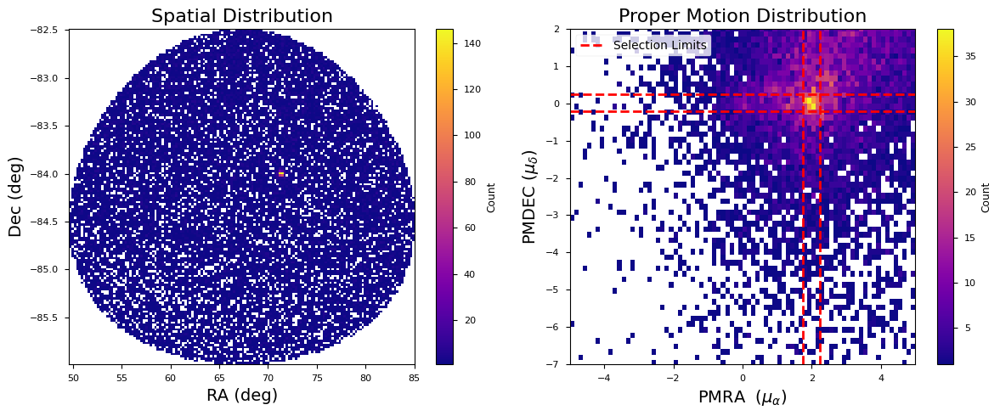

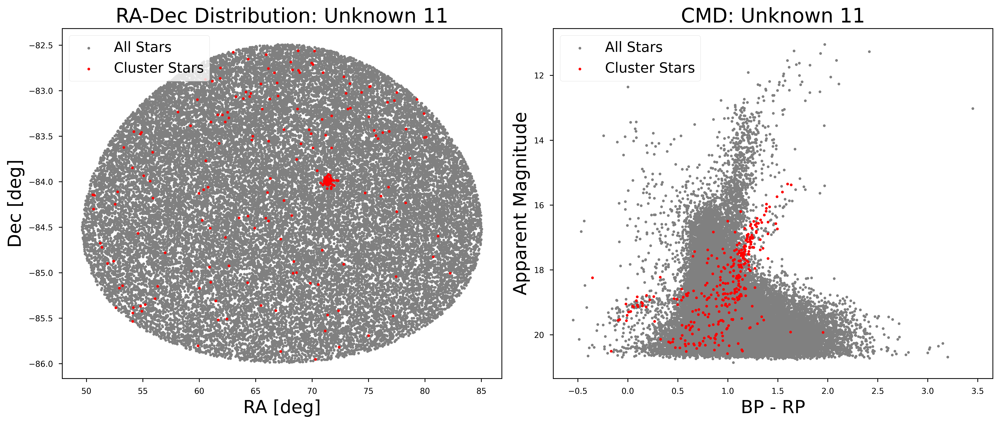

In [40]:
# Define limits for Unknown 11
pmra_bounds = (1.75, 2.25)
pmdec_bounds = (-0.2, 0.25)

cluster_11 = investigation_pipeline("Unknown_11.fits", pmra_bounds, pmdec_bounds, "Unknown 11")

,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,6.721000e+03,6721.000000,6721.000000,6721.000000,6721.000000,6721.000000,6721.000000,6721.000000,6721.000000,6721.000000,...,6721.000000,6721.000000,56.000000,2206.000000,2206.000000,2206.000000,6721.000000,6721.000000,6721.000000,6721.000000
mean,4.615006e+18,297.471652,-30.344758,67.656437,-84.220652,0.341536,0.347488,19.295515,19.772430,18.606611,...,3.865084,3.892289,104.378189,-1.612046,5125.573730,4.608472,1.165819,5746.228027,7164.666016,4672.759766
std,3.862049e+14,0.437394,0.364541,3.759800,0.364150,0.310763,0.312030,1.265668,1.289741,1.220722,...,3.607497,5.206824,109.652931,0.760548,564.147522,0.414293,0.374088,3323.164795,4343.368652,2597.004150
min,4.614359e+18,296.634635,-31.117184,59.852893,-84.985415,0.008763,0.009356,11.381288,12.486688,10.344624,...,-10.544024,-27.423963,-47.350822,-4.118400,3551.896729,1.140000,-0.318186,310.661346,348.086578,286.315918
25%,4.614814e+18,297.061370,-30.632460,64.582613,-84.514720,0.127186,0.128873,18.589056,19.032047,17.971653,...,1.852125,0.426225,29.525688,-1.958250,4873.221191,4.639000,0.938389,3521.954834,4195.262695,2949.536133
50%,4.614895e+18,297.450769,-30.309497,67.820594,-84.178581,0.243212,0.252289,19.571299,20.055862,18.890278,...,3.287341,3.537735,84.958847,-1.570050,5111.608887,4.747550,1.096054,4768.574219,5905.655273,3924.372559
75%,4.615260e+18,297.835658,-30.082488,71.143275,-83.963176,0.447125,0.454386,20.278727,20.761463,19.512705,...,5.349670,6.685625,118.940346,-1.229250,5327.039551,4.790800,1.343021,7058.584961,8900.264648,5742.572754
max,4.615706e+18,298.364244,-29.621294,74.811097,-83.494400,2.564636,2.713724,20.960705,22.380562,20.803844,...,56.146886,96.703151,372.027313,0.389800,19273.062500,5.042300,3.286652,32464.962891,44270.929688,24211.822266


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



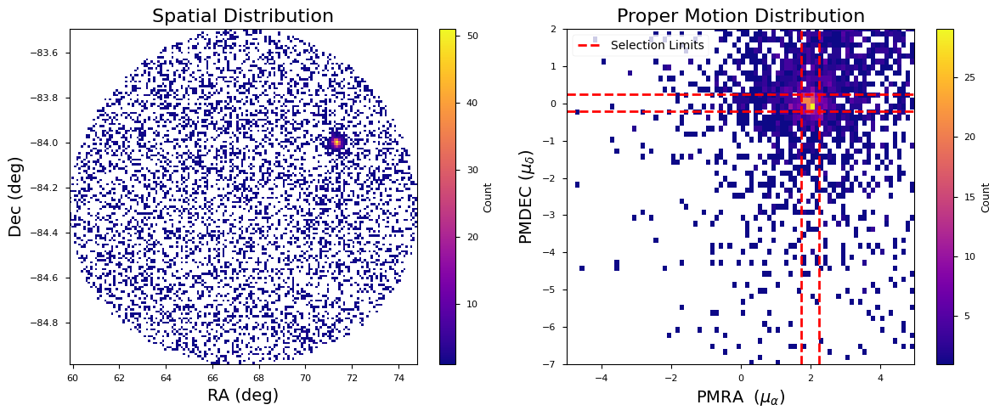

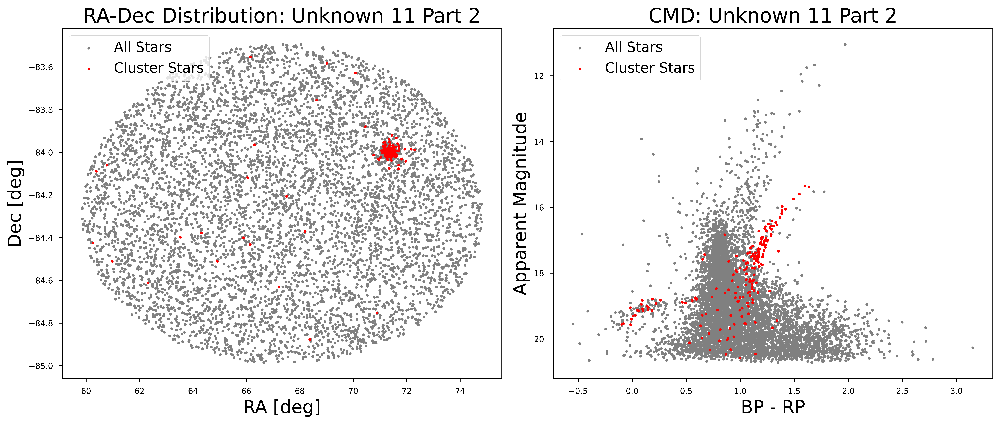

In [41]:
# Define limits for Unknown 11 - Again
pmra_bounds = (1.75, 2.25)
pmdec_bounds = (-0.2, 0.25)

cluster_11 = investigation_pipeline("Unknown_11_2.fits", pmra_bounds, pmdec_bounds, "Unknown 11 Part 2")

# Unknown 12
- This is on the boundary of the SMC/ just within it
- It is likely just the boundary of the SMC

,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,3.071000e+03,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,3071.000000,...,3071.000000,3071.000000,18.000000,915.000000,915.000000,915.000000,3071.000000,3071.000000,3071.000000,3071.000000
mean,4.682033e+18,304.488072,-40.381133,7.706230,-76.682045,0.360923,0.335972,19.366964,19.793118,18.748203,...,3.095763,-1.857802,103.666931,-1.344869,5227.558105,4.521271,1.044914,6368.566406,7981.180176,5104.604980
std,9.547377e+15,0.325652,0.249852,1.077886,0.249696,0.331971,0.306769,1.208512,1.184934,1.201570,...,4.836196,3.151549,89.559715,0.777173,918.775879,0.517958,0.367025,3772.064209,4875.340332,2960.648438
min,4.635879e+18,303.853641,-40.868098,5.512755,-77.186981,0.008719,0.008369,10.975075,11.909188,10.021919,...,-21.274566,-37.975083,-19.034803,-4.095400,3937.573486,0.327100,-0.224804,338.789490,378.090027,271.202972
25%,4.683935e+18,304.228728,-40.587386,6.864531,-76.879799,0.143193,0.132906,18.765121,19.201878,18.192930,...,0.507715,-2.392146,20.773636,-1.772100,4783.908203,4.509100,0.842596,3775.778320,4561.522461,3118.785767
50%,4.683976e+18,304.489845,-40.378572,7.700911,-76.684105,0.243384,0.223285,19.528612,19.978319,18.941456,...,1.083544,-1.410391,108.661148,-1.425200,5095.297363,4.706500,1.019123,5303.629395,6592.160645,4323.122070
75%,4.684013e+18,304.745723,-40.182562,8.577567,-76.477141,0.463580,0.439061,20.307737,20.678487,19.632545,...,5.017214,-0.909014,142.690170,-0.840150,5481.016113,4.779650,1.199136,8070.374512,10191.517090,6478.362549
max,4.684219e+18,305.152600,-39.877463,9.816273,-76.195768,2.413374,2.173118,20.982197,22.453184,20.898998,...,85.324699,21.178509,257.421356,0.626700,18076.720703,4.966300,2.811796,29310.875000,37961.542969,24058.623047


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



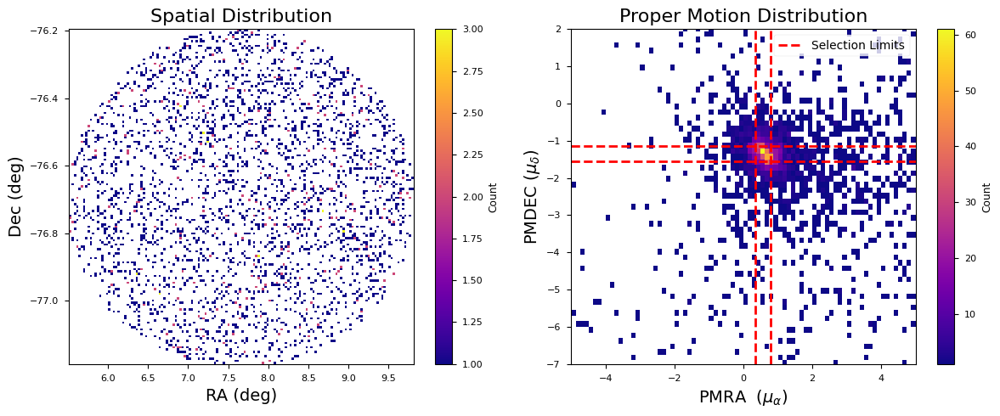

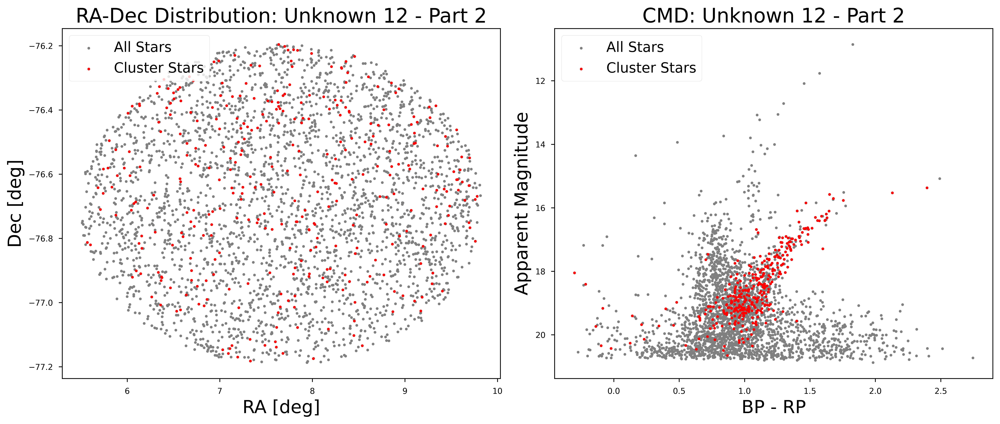

In [42]:
# Define limits for Unknown 12 - Part 2
pmra_bounds = (0.35, 0.8)
pmdec_bounds = (-1.55, -1.15)

cluster_12 = investigation_pipeline("Unknown_12_2.fits", pmra_bounds, pmdec_bounds, "Unknown 12 - Part 2")

## Unknown 1 - M33

In [ ]:
# Define limits for Unknown 1
pmra_bounds = (-0.2, 0.25)
pmdec_bounds = (-0.2, 0.25)

cluster_1 = investigation_pipeline("Unknown_1.fits", pmra_bounds, pmdec_bounds, "Unknown 1")

# The rest are likely False Positives

## Unknown 2

,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,2.758800e+04,27588.000000,27588.000000,27588.000000,27588.000000,27588.000000,27588.000000,27588.000000,27588.000000,27588.000000,...,27588.000000,27588.000000,333.000000,8846.000000,8846.000000,8846.000000,27588.000000,27588.000000,27588.000000,27588.000000
mean,1.706568e+18,177.513038,-19.229737,67.665255,19.679926,0.463451,0.247934,19.286318,19.947216,18.437008,...,1.111972,-1.746482,8.670012,-2.015733,4728.079102,4.727215,1.510210,4054.182129,4935.211914,3381.546143
std,1.633956e+18,0.937694,0.873155,0.945249,0.868149,0.383686,0.191795,1.241683,1.233845,1.203845,...,2.652886,2.813306,30.665014,0.884222,705.882690,0.449943,0.321182,2039.808105,2557.204834,1643.852051
min,4.785367e+16,175.650091,-21.116380,65.687967,17.857380,0.012474,0.007210,11.567099,12.577162,10.382449,...,-28.582787,-53.740834,-110.397972,-4.132100,3451.362549,1.094400,0.064997,210.558548,210.558548,207.454880
25%,1.441999e+17,176.732408,-19.867987,66.902944,18.993911,0.180293,0.101718,18.625289,19.257828,17.836198,...,-0.121456,-2.319790,-10.765475,-2.663200,4345.046875,4.733725,1.294395,2688.496155,3234.653870,2268.293457
50%,1.445907e+17,177.515121,-19.174399,67.717077,19.704284,0.346965,0.194073,19.555369,20.273048,18.716250,...,0.708539,-1.178230,8.376208,-2.041900,4678.255859,4.875550,1.453610,3504.574829,4264.510254,2956.942505
75%,3.410453e+18,178.277499,-18.521755,68.445396,20.381300,0.640364,0.346156,20.255171,20.885832,19.334342,...,1.832778,-0.398980,27.926817,-1.547925,5003.411133,4.942775,1.673018,4869.309082,5896.162476,4092.373108
max,3.411289e+18,179.353453,-17.622106,69.400410,21.352851,3.486843,1.540149,21.079760,22.894428,20.614046,...,60.284326,16.193734,145.260056,0.785500,34990.531250,5.218000,3.924921,18950.226562,24356.050781,14942.628906


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



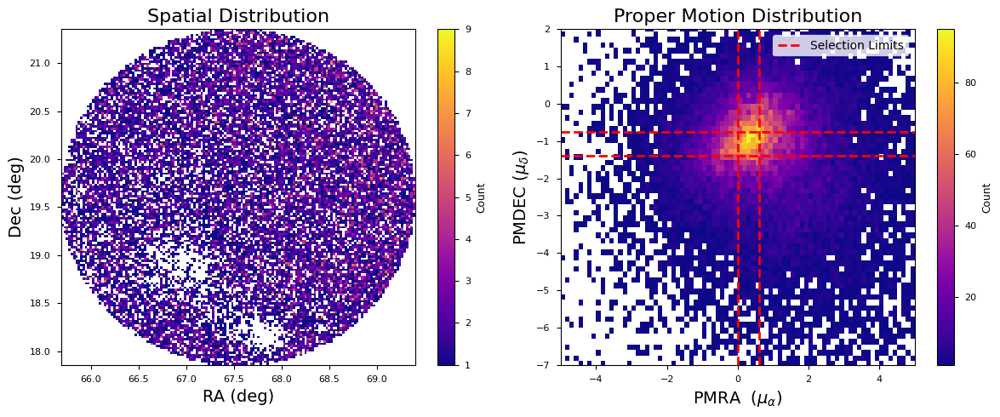

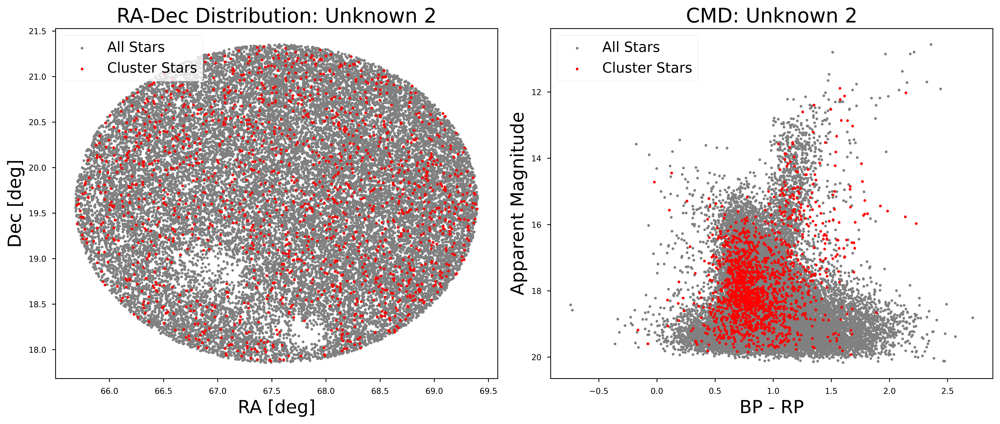

In [9]:
# Define limits for Unknown 2
pmra_bounds = (0, 0.6)
pmdec_bounds = (-1.4, -0.75)

cluster_2 = investigation_pipeline("Unknown_2.fits", pmra_bounds, pmdec_bounds, "Unknown 2")

,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,2.930600e+04,29306.000000,29306.000000,29306.000000,29306.000000,29306.000000,29306.000000,29306.000000,29306.000000,29306.000000,...,29306.000000,29306.000000,270.000000,10809.000000,10809.000000,10809.000000,29306.000000,29306.000000,29306.000000,29306.000000
mean,9.478411e+17,177.506144,20.558555,107.736028,40.022466,0.419838,0.398429,19.133104,19.619352,18.455317,...,0.317554,-2.790272,-0.180386,-1.512355,5327.125000,4.687844,1.164035,4878.885254,5872.142090,4057.764160
std,9.299907e+14,0.931236,0.864055,1.130250,0.870489,0.357192,0.349730,1.354225,1.431191,1.273053,...,2.314056,3.362143,48.946404,0.691521,637.201538,0.343175,0.451652,2765.733154,3414.122559,2257.205811
min,9.462998e+17,175.631432,18.882586,105.536478,38.306877,0.010832,0.010361,10.325370,11.803533,9.155567,...,-27.097410,-69.701679,-229.245331,-4.139000,3290.804199,0.172800,-0.376793,205.701538,220.075073,190.085602
25%,9.471401e+17,176.756077,19.860426,106.828714,39.315255,0.150841,0.144577,18.391029,18.777795,17.817021,...,-0.718352,-3.671955,-25.730553,-1.917800,4947.078613,4.692200,0.818322,2903.744141,3403.334534,2472.341125
50%,9.477672e+17,177.500859,20.535166,107.707797,40.018306,0.309853,0.294117,19.443040,19.945189,18.758720,...,0.197877,-1.858264,-1.658823,-1.531500,5383.226074,4.746600,1.042020,4052.120605,4854.542725,3426.005493
75%,9.483369e+17,178.263327,21.247137,108.631358,40.715266,0.587701,0.545263,20.200837,20.734678,19.390503,...,1.187133,-0.930699,23.548115,-1.082800,5693.789062,4.796900,1.457839,6345.003784,7626.753784,5287.343140
max,9.510008e+17,179.368969,22.375803,110.104272,41.804848,2.562367,3.205580,21.031937,23.935015,20.957897,...,44.368200,7.834013,244.985596,0.620300,11459.544922,5.209400,4.357641,23443.130859,28809.035156,17706.998047


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



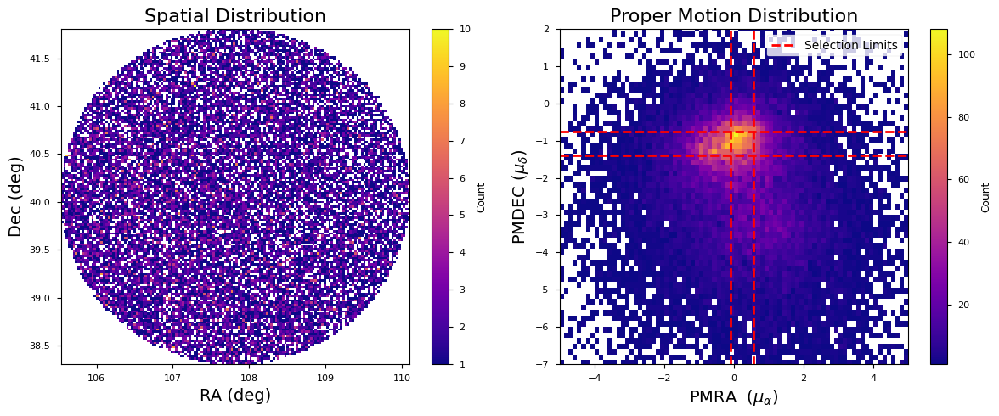

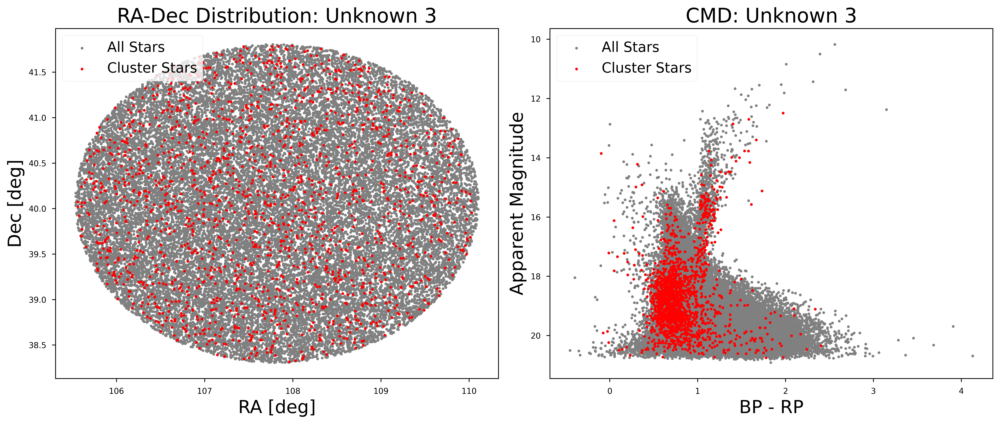

In [10]:
# Define limits for Unknown 3
pmra_bounds = (-0.1, 0.55)
pmdec_bounds = (-1.40, -0.75)

cluster_2 = investigation_pipeline("Unknown_3.fits", pmra_bounds, pmdec_bounds, "Unknown 3")

,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,4.145400e+04,41454.000000,41454.000000,41454.000000,41454.000000,41454.000000,41454.000000,41454.000000,41454.000000,41454.000000,...,41454.000000,41454.000000,608.000000,16358.000000,16358.000000,16358.000000,41454.000000,41454.000000,41454.000000,41454.000000
mean,3.291433e+18,190.534244,-19.282740,75.171768,9.757032,0.432336,0.265537,19.045708,19.554464,18.339239,...,1.091523,-1.561694,33.592152,-1.669114,5153.991699,4.698377,1.215223,4710.587891,5691.854004,3920.952881
std,1.261767e+15,0.914556,0.872500,0.879922,0.868503,0.408935,0.251455,1.397523,1.448174,1.330876,...,2.328001,2.866495,35.161549,0.652765,566.925903,0.376179,0.380665,2361.727051,2940.012939,1917.895508
min,3.288679e+18,188.646009,-21.117211,73.309165,7.988963,0.010862,0.005260,10.273065,11.562567,9.157686,...,-16.449891,-68.698122,-106.633835,-4.097800,3324.693604,1.042100,-0.336639,298.867798,346.565399,207.287720
25%,3.290743e+18,189.808215,-19.979871,74.468854,9.058923,0.139912,0.085860,18.239241,18.669271,17.628333,...,-0.014003,-2.082173,11.687251,-2.056600,4817.204590,4.717200,0.938418,3098.720154,3668.223633,2640.208740
50%,3.291309e+18,190.548616,-19.250350,75.197410,9.757091,0.296461,0.184516,19.330666,19.864907,18.638879,...,0.735076,-0.951087,33.131271,-1.712900,5146.741211,4.782300,1.128413,4143.552490,4973.246582,3490.778442
75%,3.291729e+18,191.265155,-18.572178,75.887254,10.462699,0.583871,0.358534,20.160277,20.710563,19.343603,...,1.737311,-0.211417,50.714870,-1.390000,5419.175781,4.855600,1.407426,5779.539062,6989.668701,4837.507324
max,3.295088e+18,192.354510,-17.620740,76.857117,11.487840,3.561789,1.930243,21.070644,23.745392,21.331818,...,59.719184,14.796824,288.914703,0.591400,10075.073242,5.212000,4.269627,21131.625000,25870.996094,16361.437500


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



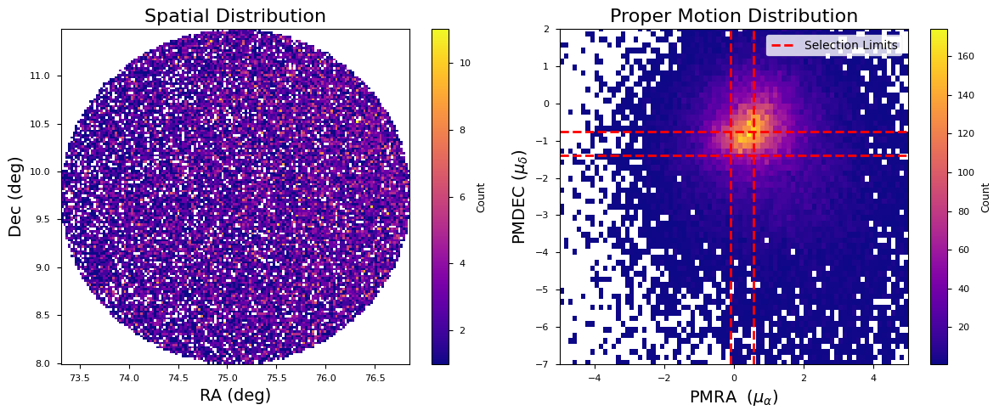

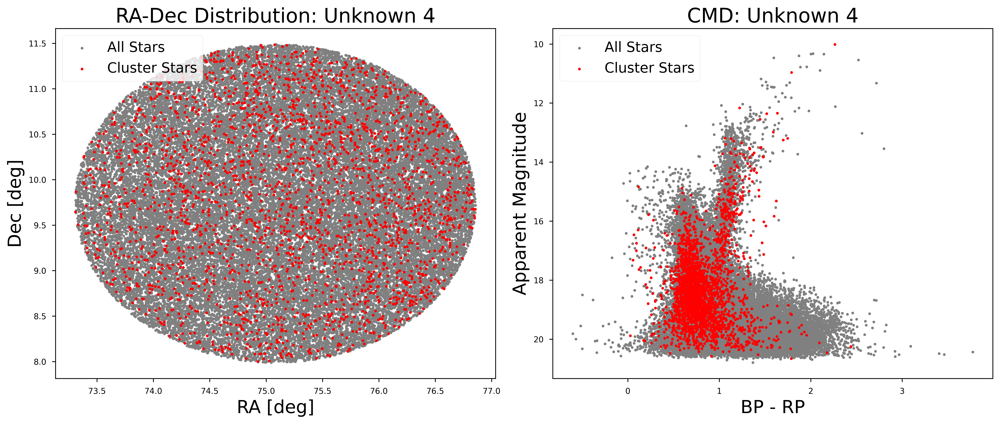

In [11]:
# Define limits for Unknown 4
pmra_bounds = (-0.1, 0.55)
pmdec_bounds = (-1.40, -0.75)

cluster_2 = investigation_pipeline("Unknown_4.fits", pmra_bounds, pmdec_bounds, "Unknown 4")

,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,4.991800e+04,49918.000000,49918.000000,49918.000000,49918.000000,49918.000000,49918.000000,49918.000000,49918.000000,49918.000000,...,49918.000000,49918.000000,597.000000,21150.000000,21150.000000,21150.000000,49918.000000,49918.000000,49918.000000,49918.000000
mean,2.596463e+18,194.498137,14.546809,108.086288,22.761498,0.393319,0.369825,18.915298,19.405504,18.239813,...,-0.126791,-2.208942,38.089375,-1.514493,5303.936523,4.701852,1.165693,4459.018555,5295.764648,3782.261230
std,1.153901e+18,0.905690,0.877005,0.952567,0.875236,0.351630,0.360451,1.410907,1.502642,1.325317,...,2.120488,2.721374,33.696957,0.678330,640.274170,0.333046,0.432801,2389.486084,2904.087402,1989.546387
min,8.661878e+17,192.693658,12.880467,106.270900,21.047181,0.010073,0.009600,10.054470,10.957199,9.027639,...,-22.823949,-79.023555,-105.977539,-4.126700,3247.620117,1.035200,-0.478830,218.144073,313.000641,208.255692
25%,8.704300e+17,193.761349,13.825440,107.309530,22.053578,0.132594,0.122251,18.107935,18.490387,17.527560,...,-1.023683,-2.922702,16.495970,-1.946900,4917.980469,4.692100,0.835907,2879.376221,3342.171509,2488.238708
50%,3.367223e+18,194.499937,14.523786,108.049887,22.752494,0.285761,0.255194,19.218870,19.713161,18.537870,...,-0.165342,-1.615660,38.760201,-1.545500,5313.547852,4.752900,1.059477,3746.983521,4450.215576,3210.407593
75%,3.368150e+18,195.231126,15.248095,108.845745,23.461720,0.544272,0.493236,20.041919,20.602683,19.238153,...,0.680583,-0.808494,59.574409,-1.065675,5671.848633,4.813675,1.431046,5428.851807,6470.207153,4614.898438
max,3.368669e+18,196.307223,16.377296,110.063049,24.544853,2.509731,3.244934,21.021982,23.965591,20.929804,...,57.882403,16.594420,196.764114,0.778100,24042.099609,5.294200,4.438520,20010.423828,23056.628906,17784.384766


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



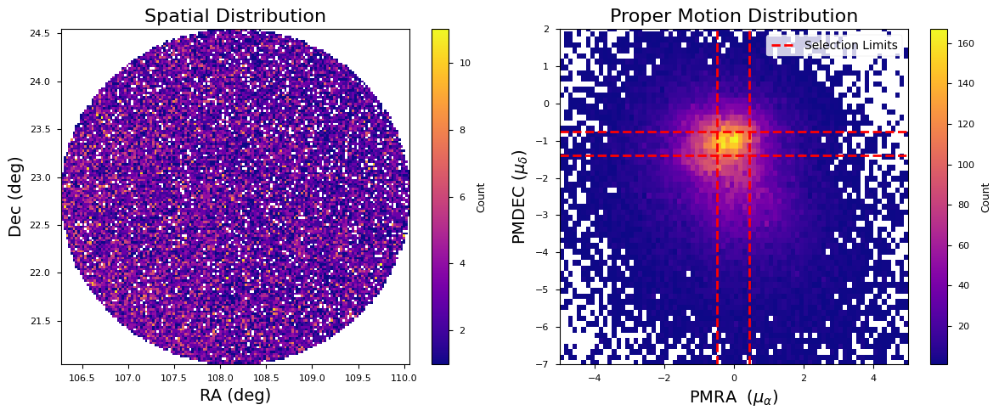

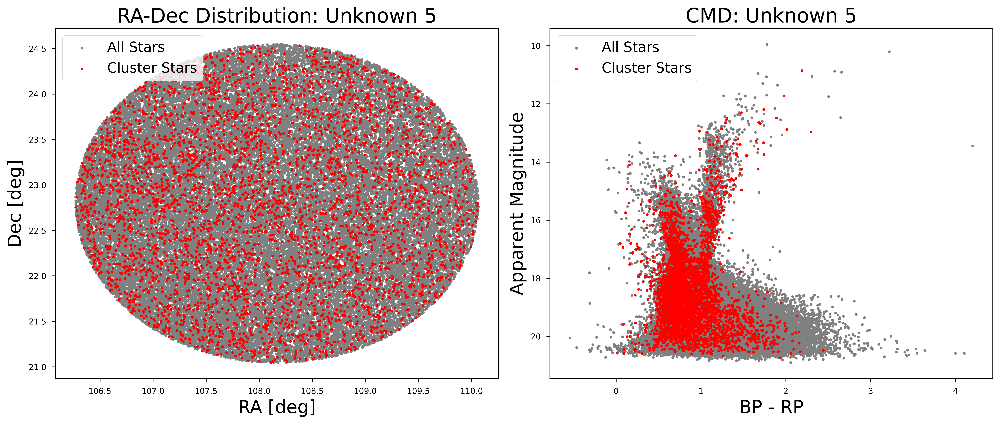

In [14]:
# Define limits for Unknown 5
pmra_bounds = (-0.5, 0.45)
pmdec_bounds = (-1.40, -0.75)

cluster_2 = investigation_pipeline("Unknown_5.fits", pmra_bounds, pmdec_bounds, "Unknown 5")

,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,6.300000e+04,63000.000000,63000.000000,63000.000000,63000.000000,63000.000000,63000.000000,63000.000000,63000.000000,63000.000000,...,63000.000000,63000.000000,802.000000,27475.000000,27475.000000,27475.000000,63000.000000,63000.000000,63000.000000,63000.000000
mean,3.363665e+18,197.474692,12.502212,107.358514,19.284285,0.376659,0.353710,18.832792,19.333134,18.153320,...,-0.217630,-1.921088,44.534523,-1.524219,5265.563477,4.699025,1.179811,4316.350098,5114.680664,3677.159180
std,1.839715e+15,0.889506,0.878302,0.925351,0.873272,0.338678,0.337569,1.437339,1.528692,1.355597,...,1.883558,2.501151,36.816437,0.675136,663.268860,0.344679,0.412940,2200.350586,2664.902100,1834.358398
min,3.360670e+18,195.708554,10.880072,105.636638,17.567110,0.010604,0.009509,10.418061,11.670282,9.335376,...,-24.860073,-69.323525,-146.452133,-4.136100,3266.713379,0.500000,-0.421940,340.448120,456.908234,278.337646
25%,3.361852e+18,196.761503,11.775019,106.600419,18.579809,0.123337,0.112671,17.994096,18.385254,17.410966,...,-1.055508,-2.583843,21.546019,-1.971050,4853.616211,4.688600,0.871969,2912.438416,3381.754211,2520.560486
50%,3.363368e+18,197.467727,12.457714,107.304872,19.269240,0.274236,0.246397,19.149224,19.646120,18.458171,...,-0.235271,-1.417254,44.023010,-1.574400,5238.877930,4.763600,1.089859,3678.325928,4373.800049,3163.410522
75%,3.364980e+18,198.182264,13.201627,108.093134,19.985729,0.526865,0.485236,19.974854,20.548938,19.180277,...,0.565817,-0.678361,67.129990,-1.087700,5598.711914,4.845150,1.415561,5112.656616,6092.589600,4368.297119
max,3.367023e+18,199.293051,14.378387,109.344590,21.065621,2.616382,3.264501,20.966463,23.327148,21.183395,...,40.753333,29.509919,292.791748,0.786200,12807.343750,5.238000,3.669720,20800.115234,23036.101562,16463.320312


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



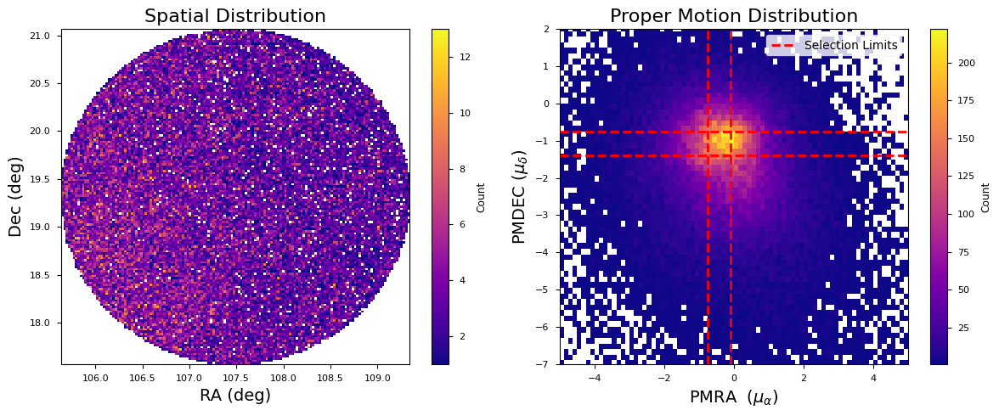

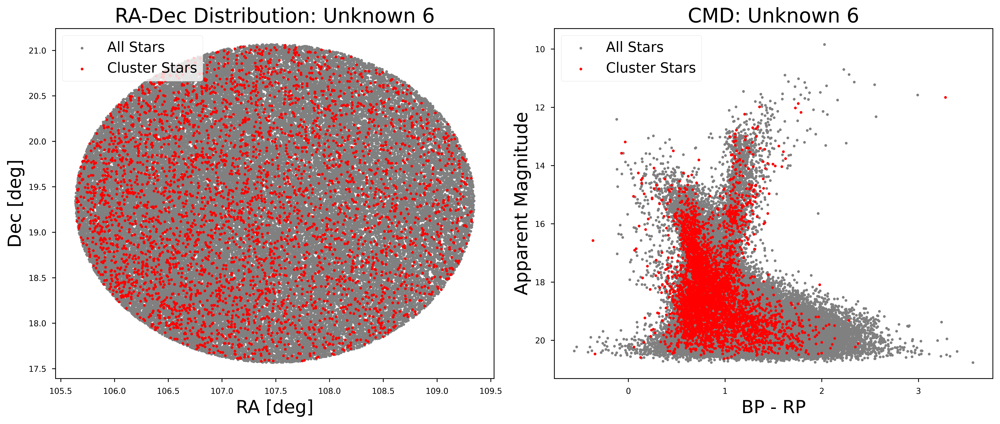

In [16]:
# Define limits for Unknown 6
pmra_bounds = (-0.75, -0.1)
pmdec_bounds = (-1.4, -0.75)

cluster_2 = investigation_pipeline("Unknown_6.fits", pmra_bounds, pmdec_bounds, "Unknown 6")

,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,4.851700e+04,48517.000000,48517.000000,48517.000000,48517.000000,48517.000000,48517.000000,48517.000000,48517.000000,48517.000000,...,48517.000000,48517.000000,633.000000,18368.000000,18368.000000,18368.000000,48517.000000,48517.000000,48517.000000,48517.000000
mean,3.219382e+18,204.479120,-17.314559,83.656467,-0.620466,0.398952,0.365667,19.112309,19.645058,18.377697,...,0.822626,-0.780606,57.040432,-1.753122,5079.503418,4.688533,1.267358,4621.250488,5617.592285,3862.193848
std,1.869130e+15,0.924927,0.855409,0.856303,0.882075,0.371296,0.359487,1.367086,1.400703,1.306638,...,2.056761,2.653477,35.288788,0.737989,612.904785,0.407160,0.360644,2198.149414,2709.249268,1811.605591
min,3.216887e+18,202.667635,-19.119068,81.869890,-2.405597,0.010134,0.008611,10.638496,11.709547,9.570875,...,-21.621366,-65.020233,-74.958580,-4.127900,3385.713623,0.933700,-0.329222,264.400360,342.736023,240.013718
25%,3.217531e+18,203.704754,-17.978271,82.986297,-1.331725,0.131760,0.115779,18.324196,18.794584,17.675520,...,-0.119783,-1.301895,35.564701,-2.163250,4759.118164,4.715600,1.012791,3118.182617,3763.437256,2647.911377
50%,3.219336e+18,204.496571,-17.318952,83.682726,-0.592828,0.286730,0.250876,19.392904,19.962189,18.669498,...,0.595004,-0.367522,54.057556,-1.778650,5041.394043,4.792000,1.197443,4100.349121,4977.331055,3453.475586
75%,3.220921e+18,205.221855,-16.635799,84.346746,0.097431,0.525119,0.473324,20.199068,20.755989,19.369112,...,1.435753,0.425476,76.605423,-1.428575,5301.355469,4.874825,1.452330,5590.938965,6772.115234,4705.439941
max,3.222687e+18,206.330936,-15.621235,85.367899,1.084295,3.369805,2.549450,21.235441,23.561382,20.778543,...,62.266587,27.038328,348.140808,0.794300,15852.179688,5.219600,4.340469,19357.218750,24013.839844,16003.498047


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



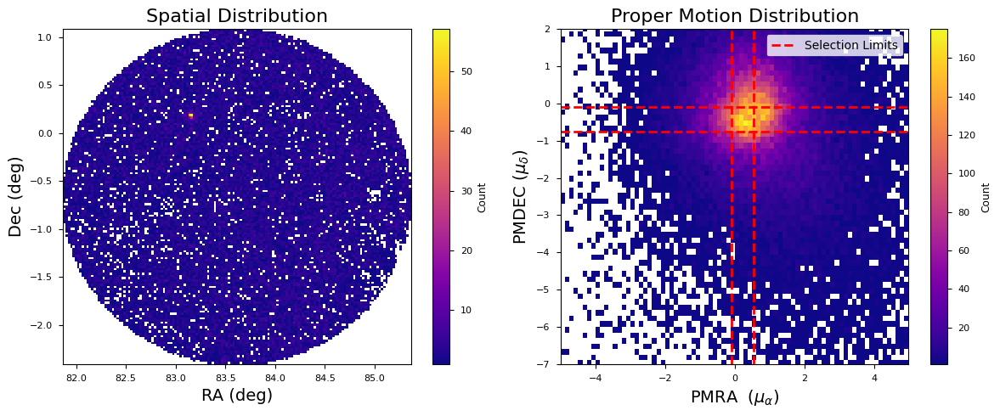

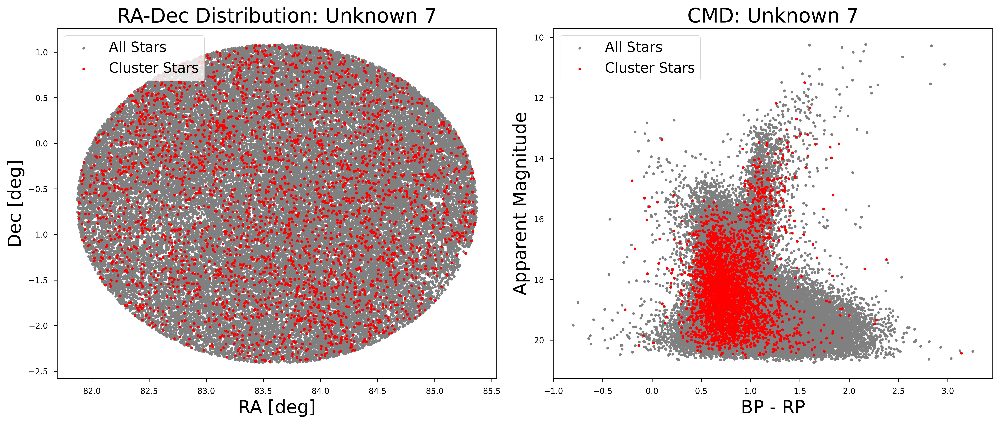

In [17]:
# Define limits for Unknown 7
pmra_bounds = (-0.1, 0.55)
pmdec_bounds = (-0.75, -0.1)

cluster_2 = investigation_pipeline("Unknown_7.fits", pmra_bounds, pmdec_bounds, "Unknown 7")

,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,5.113700e+04,51137.000000,51137.000000,51137.000000,51137.000000,51137.000000,51137.000000,51137.000000,51137.000000,51137.000000,...,51137.000000,51137.000000,674.000000,17938.000000,17938.000000,17938.000000,51137.000000,51137.000000,51137.000000,51137.000000
mean,3.018657e+18,212.535077,-16.238372,88.156225,-6.984160,0.359768,0.368926,19.202160,19.801046,18.414274,...,0.595657,-0.174172,67.006355,-1.920357,4974.933594,4.669549,1.386775,4526.668457,5543.006836,3775.196533
std,3.062897e+15,0.918775,0.832497,0.867107,0.854595,0.322341,0.349245,1.315798,1.329520,1.273532,...,1.917172,2.627781,38.308994,0.856107,676.718567,0.461683,0.342684,2102.424561,2610.325684,1728.206787
min,3.011746e+18,210.677089,-18.119189,86.262209,-8.760968,0.008433,0.007811,10.414919,11.656783,9.134663,...,-19.533421,-78.374391,-128.592926,-4.121600,3516.660400,0.369700,-0.164837,270.961182,319.299164,201.208344
25%,3.017930e+18,211.795119,-16.862843,87.493931,-7.658364,0.130578,0.127916,18.471128,19.023691,17.753036,...,-0.280775,-0.755772,45.072659,-2.452350,4609.098145,4.689825,1.149387,3090.697998,3779.552002,2598.144287
50%,3.018879e+18,212.543102,-16.196349,88.201282,-6.995683,0.261325,0.259780,19.486259,20.118317,18.705465,...,0.413300,0.134511,65.212921,-1.950350,4891.318359,4.797700,1.331530,4023.818604,4948.619629,3376.121338
75%,3.021961e+18,213.284692,-15.598409,88.855965,-6.302105,0.476094,0.476082,20.231005,20.839678,19.368595,...,1.194948,1.003343,86.288826,-1.484425,5192.122070,4.898200,1.569658,5443.625000,6656.495605,4565.319824
max,3.022764e+18,214.321456,-14.620994,89.786393,-5.263805,2.475160,2.517133,21.080120,23.340296,21.171152,...,31.217880,25.761036,368.796417,0.788000,15006.356445,5.217500,4.583355,19881.294922,23210.166016,16450.677734


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



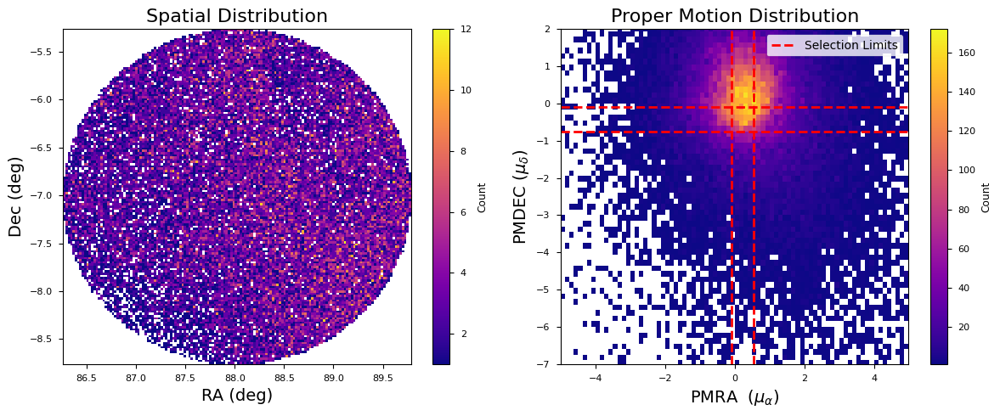

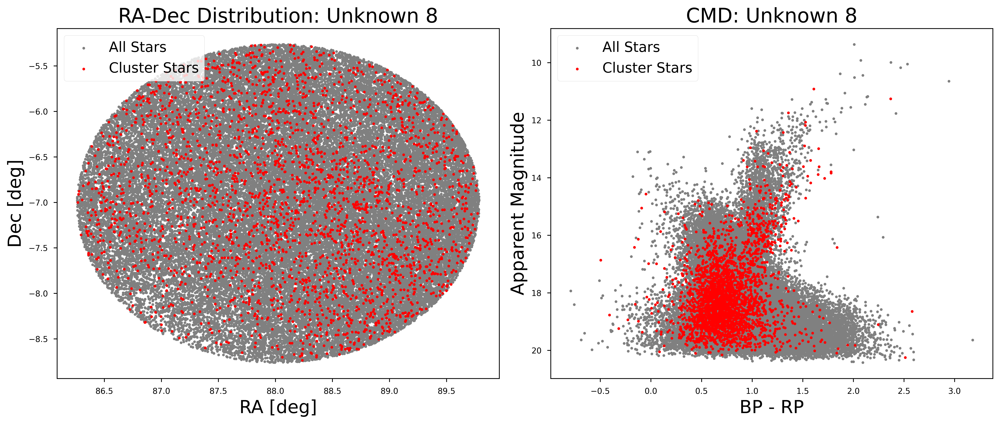

In [18]:
# Define limits for Unknown 8
pmra_bounds = (-0.1, 0.55)
pmdec_bounds = (-0.75, -0.1)

cluster_2 = investigation_pipeline("Unknown_8.fits", pmra_bounds, pmdec_bounds, "Unknown 8")

,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,7.322200e+04,73222.000000,73222.000000,73222.000000,73222.000000,73222.000000,73222.000000,73222.000000,73222.000000,73222.000000,...,73222.000000,73222.000000,921.000000,32197.000000,32197.000000,32197.000000,73222.000000,73222.000000,73222.000000,73222.000000
mean,3.135026e+18,215.003017,12.057599,114.540524,3.658103,0.357710,0.308324,18.837734,19.315813,18.177843,...,-0.908698,-0.818834,72.494888,-1.436223,5368.235840,4.671047,1.137972,4551.934082,5409.813477,3859.770752
std,9.481135e+15,0.890909,0.878446,0.882626,0.868833,0.327062,0.294868,1.440527,1.528316,1.358444,...,1.963020,2.476253,35.372391,0.674002,652.107971,0.350828,0.413753,2351.615723,2861.771973,1952.037842
min,3.087178e+18,213.212229,10.380791,112.850233,1.944055,0.010098,0.008266,10.345728,11.392138,9.280587,...,-35.576327,-92.642084,-52.817020,-4.133100,3335.584229,1.275900,-0.519993,317.110779,341.981476,286.647675
25%,3.135606e+18,214.285630,11.334418,113.812337,2.957654,0.116736,0.096305,17.980982,18.353921,17.423115,...,-1.759984,-1.446000,50.528111,-1.857500,4954.898438,4.669000,0.824669,3012.280212,3502.104492,2609.652283
50%,3.137011e+18,215.004682,12.019050,114.517733,3.646812,0.254816,0.209786,19.147616,19.626788,18.479463,...,-0.862724,-0.490477,72.410439,-1.471200,5370.663086,4.740700,1.037416,3857.689331,4595.381348,3303.515503
75%,3.137917e+18,215.715200,12.764635,115.255963,4.351163,0.496466,0.425372,19.986377,20.550534,19.211162,...,-0.047053,0.297514,92.162956,-0.963500,5723.743652,4.797800,1.382851,5423.994629,6499.809814,4609.323608
max,3.138729e+18,216.789634,13.877304,116.353773,5.441780,2.537749,2.965468,21.050055,23.563990,21.081682,...,37.106202,22.071450,366.127747,0.773900,13697.145508,5.369500,3.908689,19523.298828,22412.744141,16589.605469


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



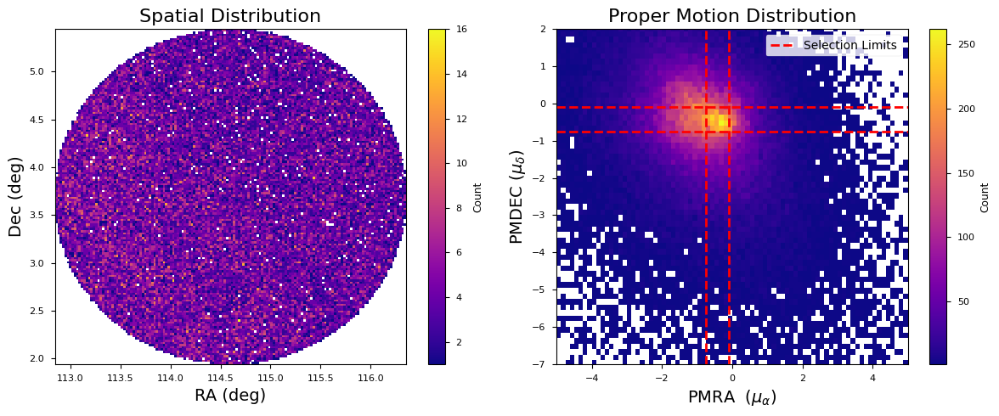

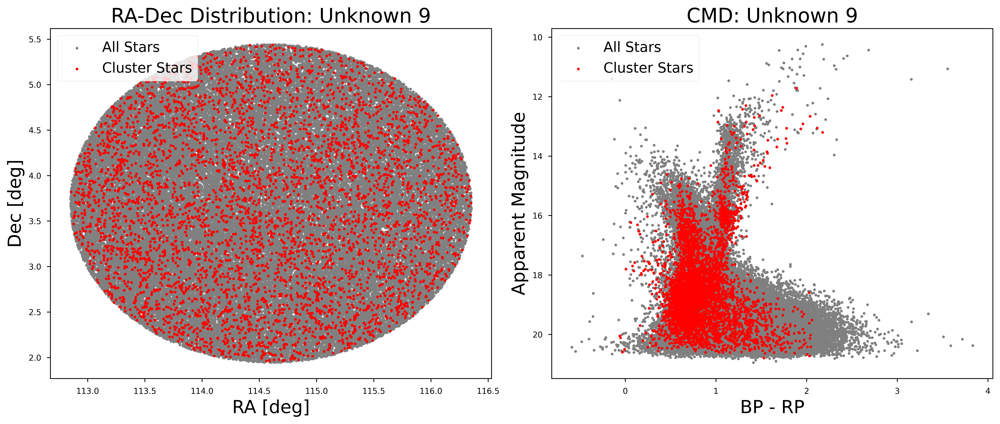

In [19]:
# Define limits for Unknown 9
pmra_bounds = (-0.75, -0.1)
pmdec_bounds = (-0.75, -0.1)

cluster_2 = investigation_pipeline("Unknown_9.fits", pmra_bounds, pmdec_bounds, "Unknown 9")

,source_id,l,b,ra,dec,ra_error,dec_error,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,...,pmra,pmdec,radial_velocity,mh_gspphot,teff_gspphot,logg_gspphot,bp_rp,r_med_photogeo,r_hi_photogeo,r_lo_photogeo
count,3.284250e+05,328425.000000,328425.000000,328425.000000,328425.000000,328425.000000,328425.000000,328425.000000,328425.000000,328425.000000,...,328425.000000,328425.000000,4011.000000,119568.000000,119568.000000,119568.000000,328425.000000,328425.000000,328425.000000,328425.000000
mean,6.111337e+18,296.509655,10.469241,182.593708,-51.880081,0.261565,0.260502,19.186192,19.684809,18.490068,...,-6.444859,0.308614,23.706011,-1.286922,5044.729980,4.603365,1.194740,5756.062500,7019.015137,4777.139160
std,8.281938e+16,0.885554,0.869913,1.409480,0.870275,0.256883,0.243357,1.330850,1.364440,1.303429,...,3.092965,2.025714,56.520882,0.660546,468.658112,0.446774,0.318638,2672.341309,3323.155518,2168.743408
min,5.368889e+18,294.720217,8.880239,179.794854,-53.479347,0.006073,0.006496,10.544230,11.703608,9.408882,...,-73.688970,-42.925415,-128.577744,-4.121500,3371.100586,0.163200,-0.530102,291.751984,378.817902,270.148376
25%,6.125167e+18,295.796115,9.752609,181.449260,-52.595575,0.088242,0.092295,18.434927,18.865540,17.793097,...,-7.967999,-0.648298,-10.726002,-1.645400,4825.391113,4.642500,0.986826,3853.807129,4649.466797,3239.304932
50%,6.125580e+18,296.515137,10.414464,182.594893,-51.933715,0.180516,0.181357,19.445648,19.950525,18.751734,...,-6.253509,0.352872,14.288354,-1.386000,5027.528320,4.748700,1.115786,5101.612793,6287.367676,4238.990234
75%,6.126279e+18,297.226043,11.147657,183.728176,-51.198780,0.341265,0.350067,20.231083,20.776463,19.470078,...,-4.731950,1.368261,46.429138,-0.881675,5194.603516,4.793600,1.338381,6981.381836,8567.107422,5782.117188
max,6.129610e+18,298.280470,12.379700,185.445923,-49.980347,2.919369,3.040804,21.158218,23.896721,21.449362,...,26.075721,32.250339,495.105804,0.784800,19993.333984,5.202700,5.142400,26074.324219,30492.273438,22900.671875


/Users/jacobtutt/Desktop/MPhil_DIS/Gal_Arc/Coursework_GA/Analysis/GA_analysis.py:1574: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()



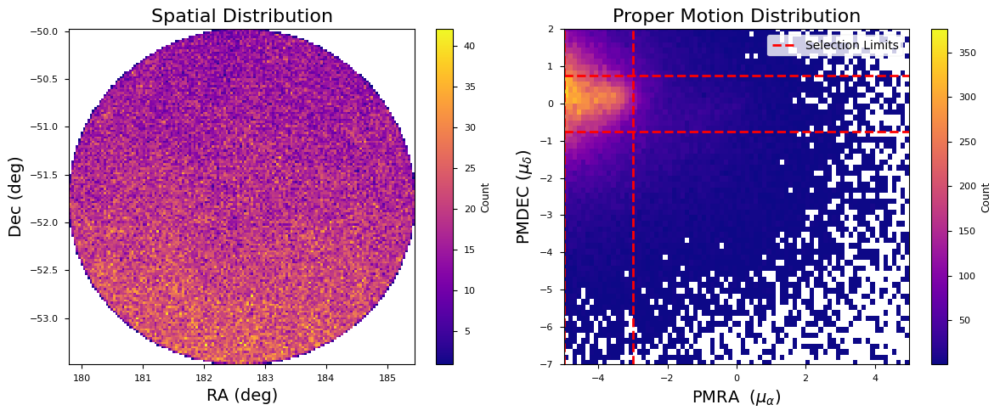

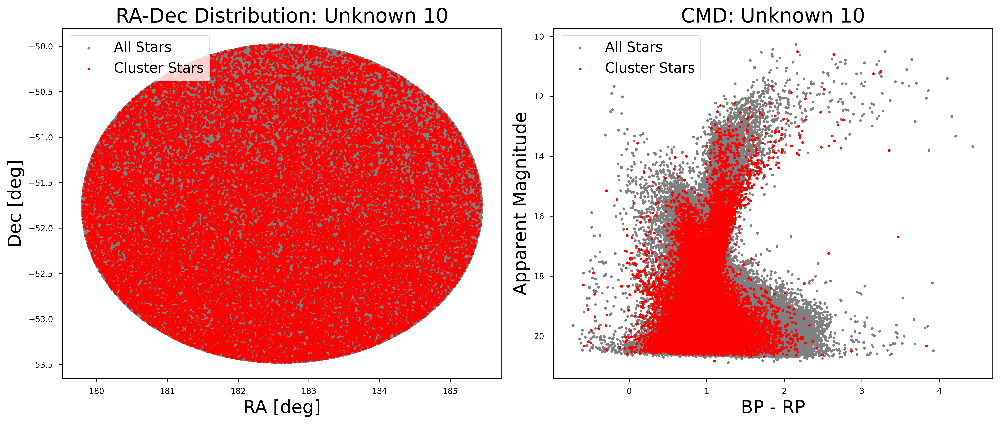

In [21]:
# Define limits for Unknown 10
pmra_bounds = (-5, -3)
pmdec_bounds = (-0.75, 0.75)

cluster_2 = investigation_pipeline("Unknown_10.fits", pmra_bounds, pmdec_bounds, "Unknown 10")